<h1 style="font-size:8vw"> EEG during sleep</h1>

<b>Authors :</b>
<ul>
  <li>Maria Valle (10911585)</li>
  <li>Guillaume Deside (10905967)</li>
  <li>Louis Ducamp (10912296)</li>
</ul>

# Import and download signal

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy import signal
import pywt

In [2]:
record = pd.read_csv("DATA/record.csv")
record = record.to_numpy()
record = record.T[0]
fs = 512 #Hz

In [3]:
print(np.log2(len(record)))

23.983973333673145


In [4]:
t= np.arange(0,len(record)/fs,1/fs)

In [5]:
time = t[-1]

time_h = time//3600
time_m = (time%3600)//60
time_s = (time%3600)%60

print("The duration of the signal is {} hours {} min and {} sec".format(time_h,time_m,round(time_s)))

The duration of the signal is 9.0 hours 0.0 min and 6 sec


### Visualization

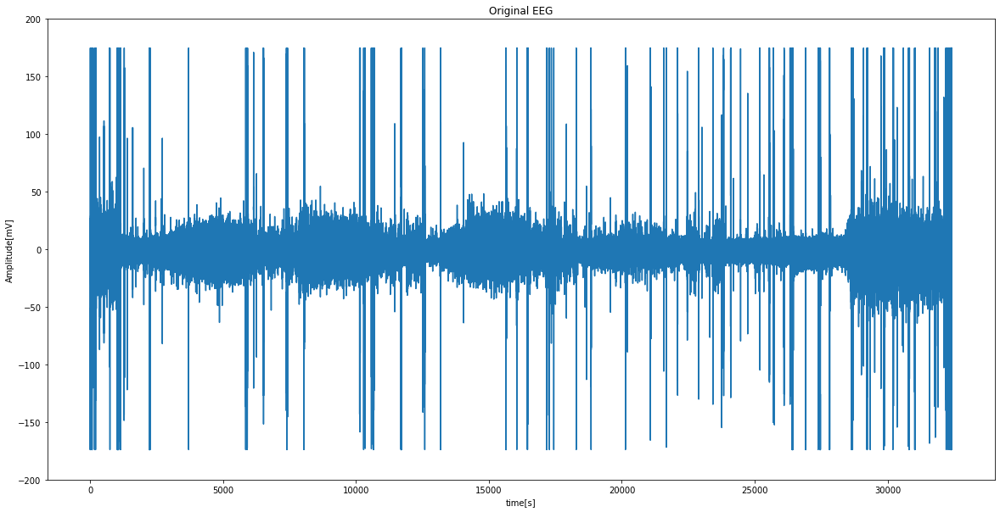

In [6]:
plt.figure(figsize=(20,10))
plt.plot(t,record)
plt.xlabel("time[s]")
plt.title("Original EEG")
plt.ylabel('Amplitude[mV]')
#plt.xlim(60,120)
plt.ylim(-200,200)
plt.savefig("figures/original_signal.png")

plt.show()

# Spectral analysis 

In [7]:
record = record -np.mean(record) 

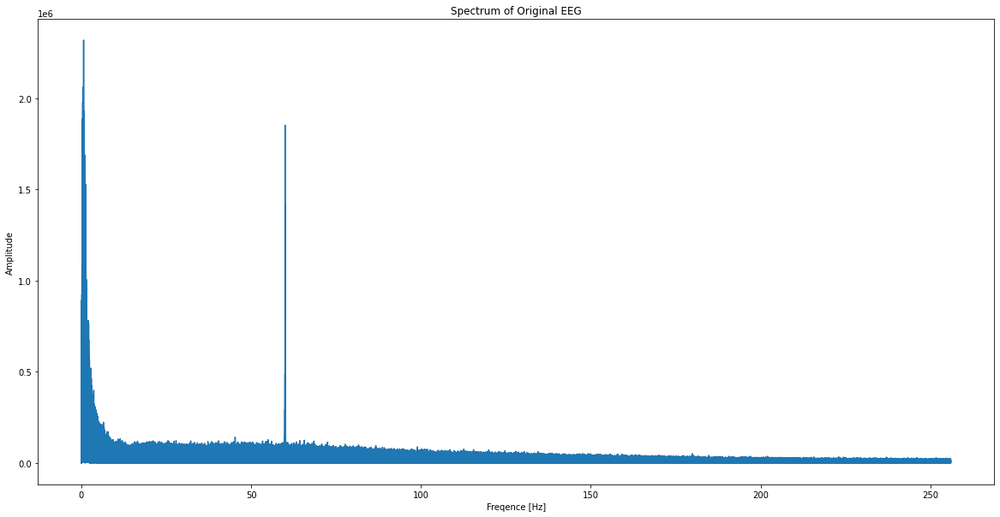

In [8]:
original_signal_freq = np.fft.fftshift(np.fft.fft(record))
original_signal_freq_abs = np.fft.fftshift(np.fft.fftfreq(original_signal_freq.size,d=1/fs))


plt.figure(figsize=(20,10))
plt.plot(original_signal_freq_abs[(len(original_signal_freq_abs)//2):],(np.abs(original_signal_freq[(len(original_signal_freq_abs)//2):])))
#plt.ylim(0,150e4)
plt.xlabel('Freqence [Hz]')
plt.ylabel('Amplitude')
plt.title("Spectrum of Original EEG")
plt.savefig("figures/signal_original_freq.png")
plt.show()

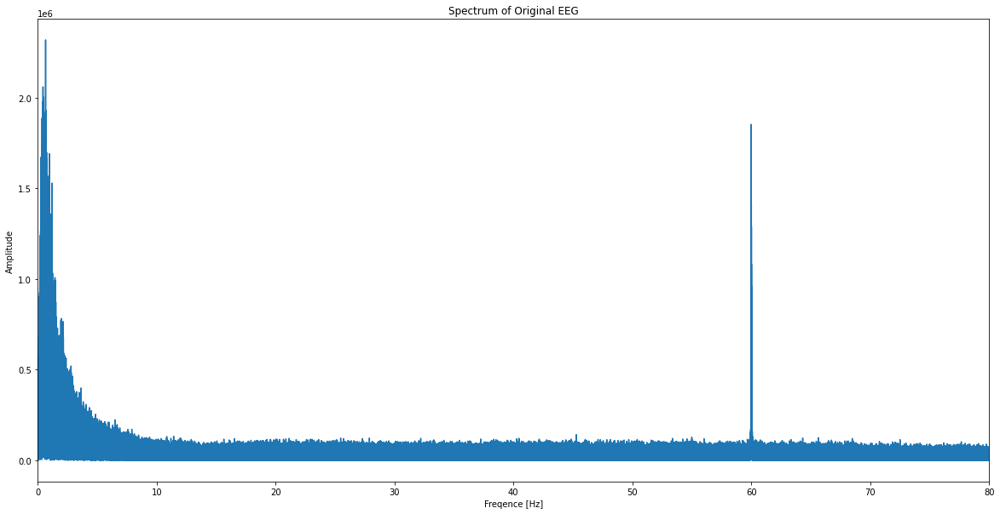

In [9]:
plt.figure(figsize=(20,10))
plt.plot(original_signal_freq_abs[(len(original_signal_freq_abs)//2):],(np.abs(original_signal_freq[(len(original_signal_freq_abs)//2):])))
#plt.ylim(0,150e4)
plt.xlim(0,80)
plt.xlabel('Freqence [Hz]')
plt.ylabel('Amplitude')
plt.title("Spectrum of Original EEG")
plt.savefig("figures/signal_original_freq.png")
plt.show()

### Comments

# Preprocessing - Filtering

### stop band filter

In [10]:
f0 = 60.0  # Frequency to be removed from signal (Hz)
Q = 30.0  # Quality factor
# Design notch filter
b, a = signal.iirnotch(f0, Q, fs)

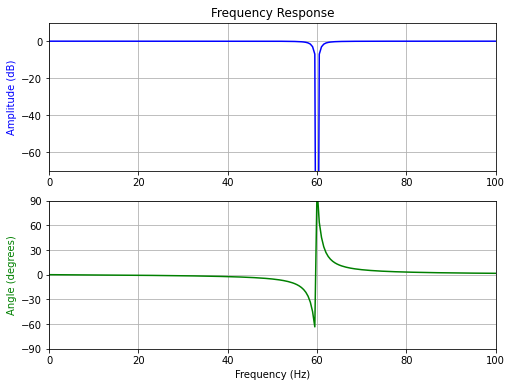

In [11]:
freq, h = signal.freqz(b, a, fs=fs)
# Plot
fig, ax = plt.subplots(2, 1, figsize=(8, 6))
ax[0].plot(freq, 20*np.log10(abs(h)), color='blue')
ax[0].set_title("Frequency Response")
ax[0].set_ylabel("Amplitude (dB)", color='blue')
ax[0].set_xlim([0, 100])
ax[0].set_ylim([-70, 10])
ax[0].grid(True)
ax[1].plot(freq, np.unwrap(np.angle(h))*180/np.pi, color='green')
ax[1].set_ylabel("Angle (degrees)", color='green')
ax[1].set_xlabel("Frequency (Hz)")
ax[1].set_xlim([0, 100])
ax[1].set_yticks([-90, -60, -30, 0, 30, 60, 90])
ax[1].set_ylim([-90, 90])
ax[1].grid(True)
plt.savefig("figures/notch_filter.png")
plt.show()

In [12]:
outputSignal = signal.filtfilt(b, a, record)

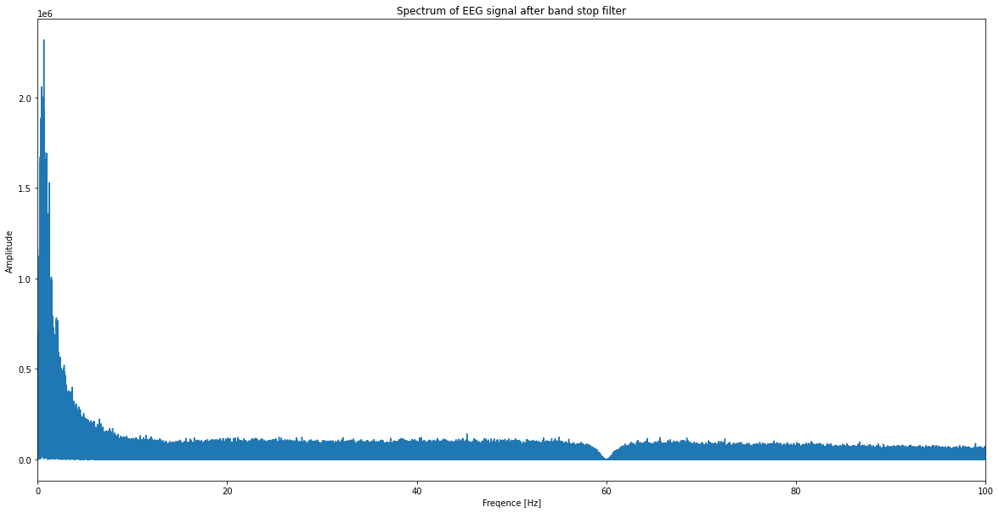

In [13]:
signal_freq_notch = np.fft.fftshift(np.fft.fft(outputSignal))
signal_freq_notch_abs = np.fft.fftshift(np.fft.fftfreq(signal_freq_notch.size,d=1/fs))

plt.figure(figsize=(20,10))
plt.plot(signal_freq_notch_abs[(len(signal_freq_notch_abs)//2):],(np.abs(signal_freq_notch[(len(signal_freq_notch_abs)//2):])))
plt.xlim(0,100)
plt.xlabel('Freqence [Hz]')
plt.ylabel('Amplitude')
plt.title("Spectrum of EEG signal after band stop filter")
plt.savefig("figures/signal_freq_filtered_1.png")
plt.show()

### band pass filter

In [14]:
b, a = signal.butter(4, [0.3,40], 'band',fs=fs)

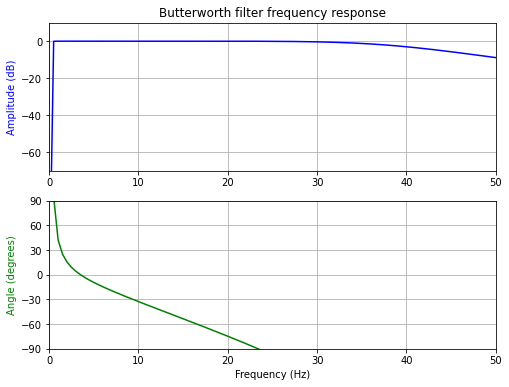

In [15]:
w, h = signal.freqz(b, a,fs=fs)

fig, ax = plt.subplots(2, 1, figsize=(8, 6))
ax[0].plot(w, 20*np.log10(abs(h)), color='blue')
ax[0].set_title("Butterworth filter frequency response")
ax[0].set_ylabel("Amplitude (dB)", color='blue')
ax[0].set_xlim([0, 50])
ax[0].set_ylim([-70, 10])
ax[0].grid(True)
ax[1].plot(w, np.unwrap(np.angle(h))*180/np.pi, color='green')
ax[1].set_ylabel("Angle (degrees)", color='green')
ax[1].set_xlabel("Frequency (Hz)")
ax[1].set_xlim([0, 50])
ax[1].set_yticks([-90, -60, -30, 0, 30, 60, 90])
ax[1].set_ylim([-90, 90])
ax[1].grid(True)
plt.savefig("figures/butter_filter.png")
plt.show()

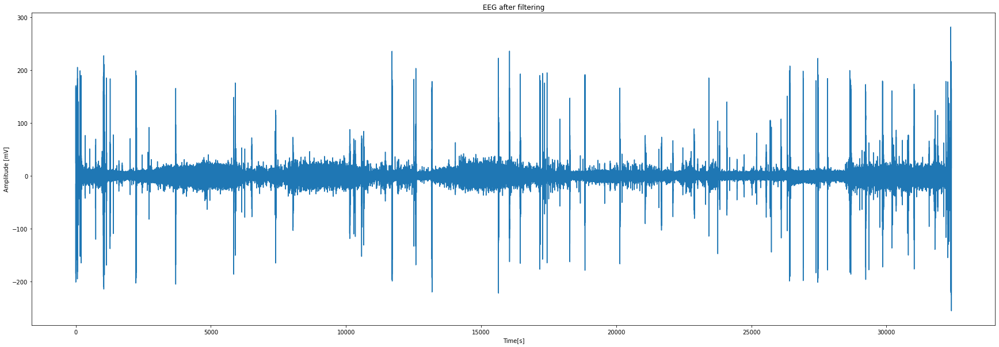

In [16]:
output = signal.filtfilt(b, a, outputSignal)
plt.figure(figsize=(30,10))
plt.plot(t,output)
#plt.xlim(0,100)
plt.xlabel("Time[s]")
plt.ylabel("Amplitude [mV]")
plt.title("EEG after filtering")
plt.savefig("figures/filtering_signal.png")
plt.show()

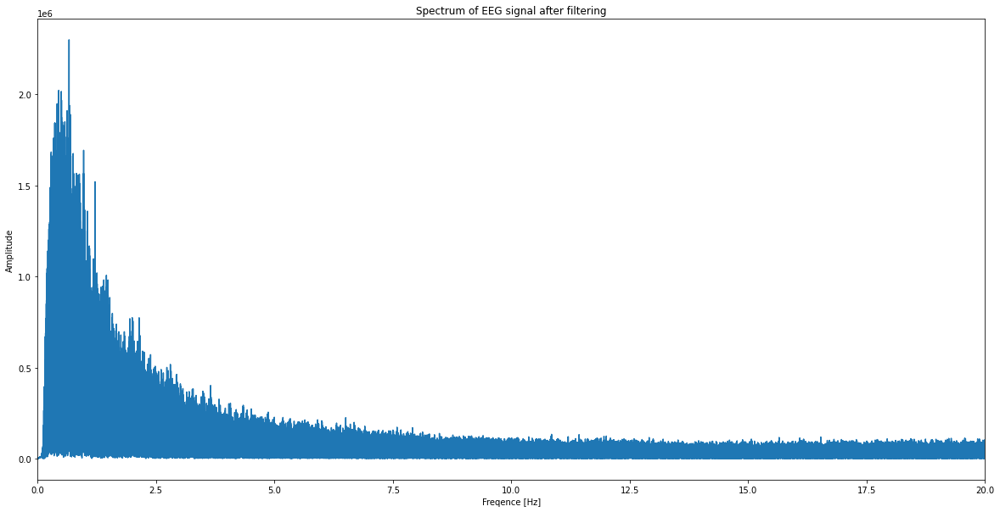

In [213]:
signal_freq = np.fft.fftshift(np.fft.fft(output))
signal_freq_abs = np.fft.fftshift(np.fft.fftfreq(signal_freq.size,d=1/fs))

plt.figure(figsize=(20,10))
plt.plot(signal_freq_abs[(len(signal_freq_abs)//2):],(np.abs(signal_freq[(len(signal_freq_abs)//2):])))
plt.xlim(0,20)
plt.xlabel('Freqence [Hz]')
plt.ylabel('Amplitude')
plt.title("Spectrum of EEG signal after filtering")
plt.savefig("figures/signal_freq_filtered_2.png")
plt.show()

# Analysis of the signal

In [209]:
output = output - np.mean(output)

# Wavelet analysis

In [210]:
coeff = pywt.wavedec(output, 'db2', level=7) #change level

new_coeff_alpha = []
new_coeff_beta =  []
new_coeff_delta = []
new_coeff_theta = []

for k in range(len(coeff)):
    new_coeff_alpha.append(np.zeros(len(coeff[k])))
    new_coeff_beta.append(np.zeros(len(coeff[k])))
    new_coeff_delta.append(np.zeros(len(coeff[k])))
    new_coeff_theta.append(np.zeros(len(coeff[k])))

new_coeff_delta[0] = coeff[0]    
new_coeff_theta[1] = coeff[1]  
new_coeff_beta[2]  = coeff[2]    
new_coeff_alpha[3] = coeff[3]



output_alpha = pywt.waverec(new_coeff_alpha, 'db2')
output_delta = pywt.waverec(new_coeff_delta, 'db2')
output_theta = pywt.waverec(new_coeff_theta, 'db2')
output_beta = pywt.waverec(new_coeff_beta, 'db2')




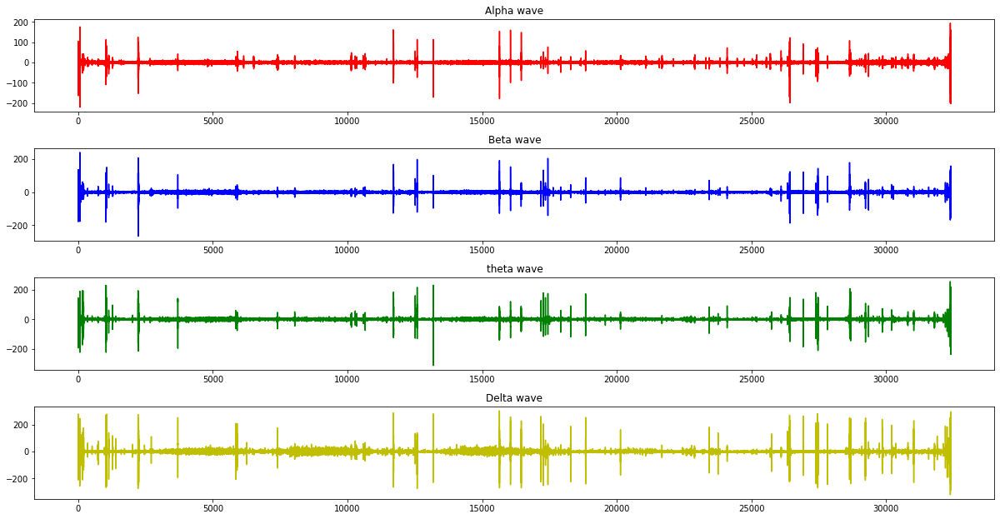

In [211]:
fig, axs = plt.subplots(4,figsize=(20,10))
plt.subplots_adjust(left=0.1,
                    bottom=0.1,
                    right=0.9,
                    top=0.9,
                    wspace=0.4,
                    hspace=0.4)

axs[0].plot(t,output_alpha,c="r")
axs[0].set_title('Alpha wave')
axs[1].plot(t,output_beta,c="b")
axs[1].set_title('Beta wave')
axs[2].plot(t,output_theta,c="g")
axs[2].set_title('theta wave')
axs[3].plot(t,output_delta,c="y")
axs[3].set_title('Delta wave')
fig.savefig("figures/signal_wav.png")

plt.show()

# Power spectral density

### divide into slot of 1h30

In [130]:
def split_data(data,time,time_slot,fs):
    N = len(data)
    nb_point_slot = time_slot * fs #[s] *[1/s]
    start_slot =0
    end_slot = nb_point_slot
    split_data = []
    while end_slot<=N:
        t_slot = time[start_slot:end_slot]
        x_slot = data[start_slot:end_slot]
        split_data.append([t_slot, x_slot])
        start_slot += nb_point_slot
        end_slot += nb_point_slot
        
    return np.array(split_data)
    

In [131]:
split_data = split_data(output,t,30,fs)

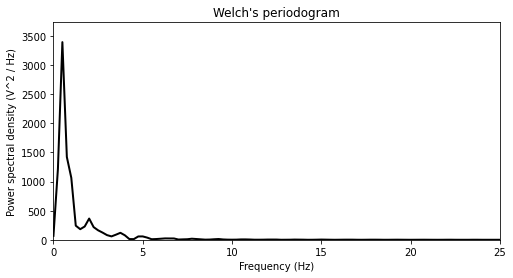

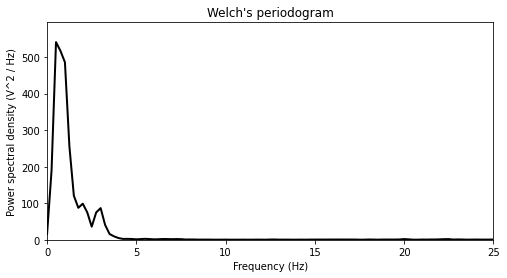

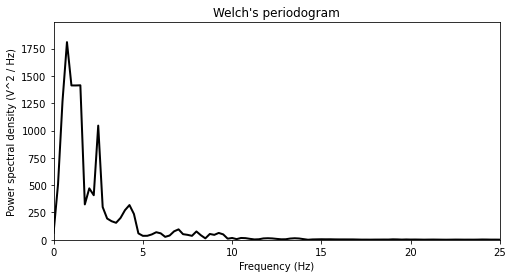

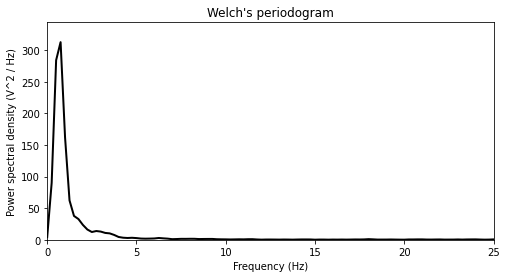

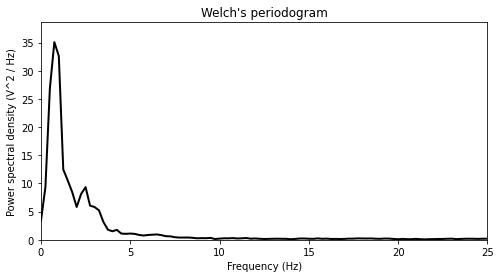

...

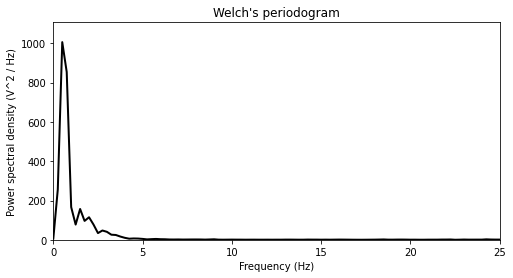

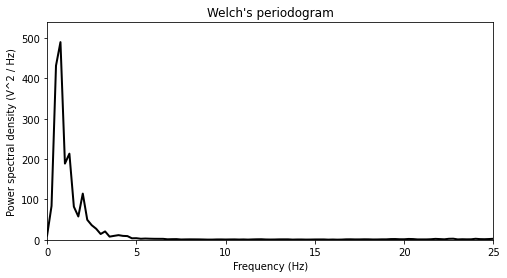

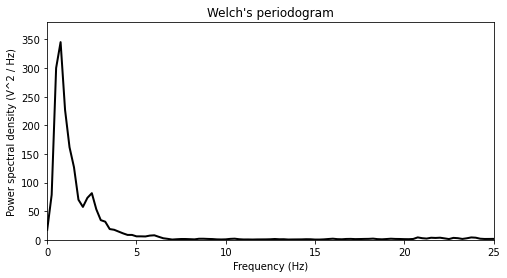

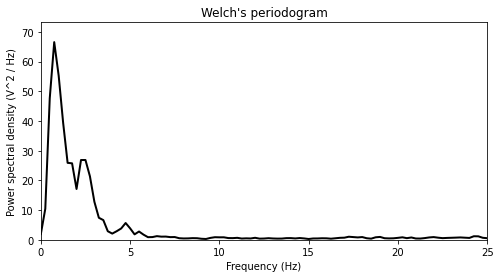

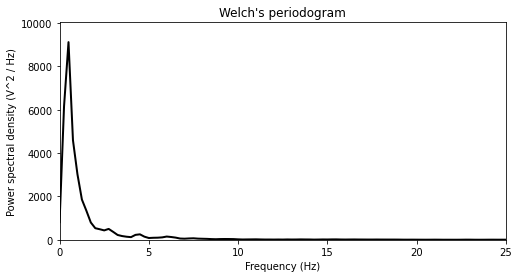

In [132]:
for k in range(len(split_data)):
    win = 4 * fs
    freqs, psd = signal.welch(split_data[k][1], fs, nperseg=win)
    plt.figure(figsize=(8, 4))
    plt.plot(freqs, psd, color='k', lw=2)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power spectral density (V^2 / Hz)')
    plt.ylim([0, psd.max() * 1.1])
    plt.xlim(0,25)
    plt.title("Welch's periodogram")
    plt.show()

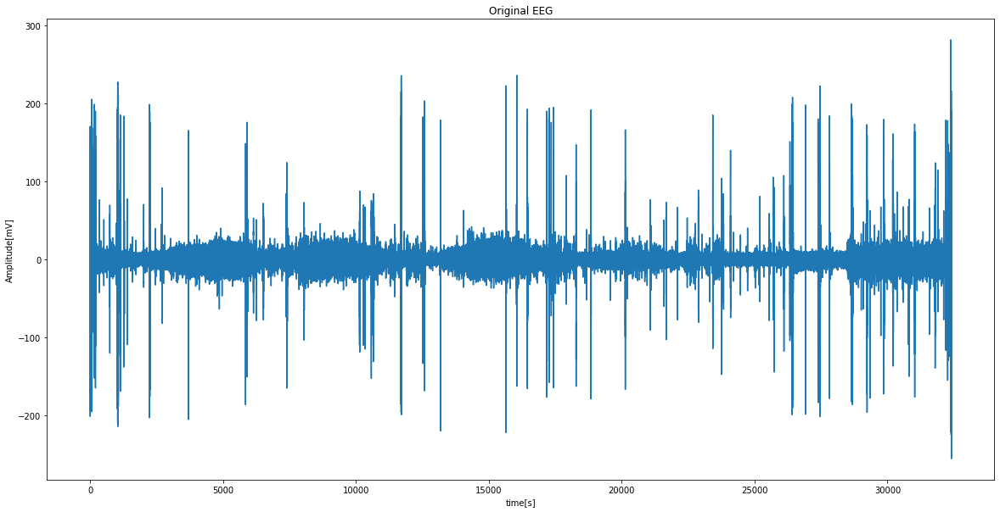

In [127]:
t_1 = np.arange(0,5400,1/fs)
l = len(t_1)

plt.figure(figsize=(20,10))
plt.plot(t,output)
plt.xlabel("time[s]")
plt.title("Original EEG")
plt.ylabel('Amplitude[mV]')
plt.savefig("figures/original_signal_1H30.png")
plt.show()

In [128]:
(f, S) = signal.welch(output, fs,nperseg=4*512)

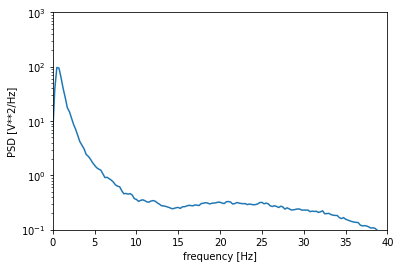

In [129]:
import matplotlib.pyplot as plt

plt.semilogy(f, S)
plt.xlim(0,40)
plt.ylim(10**-1,1000)
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [V**2/Hz]')
plt.show()

# Supplementary code 

## Notch filter

In [22]:
fs = 512.0  # Sample frequency (Hz)
f0 = 60.0  # Frequency to be removed from signal (Hz)
Q = 30.0  # Quality factor
# Design notch filter
b, a = signal.iirnotch(f0, Q, fs)

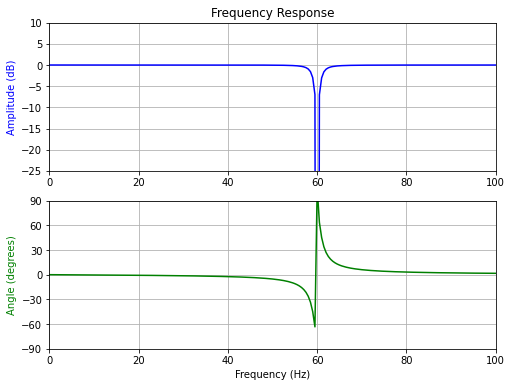

In [23]:
freq, h = signal.freqz(b, a, fs=fs)
# Plot
fig, ax = plt.subplots(2, 1, figsize=(8, 6))
ax[0].plot(freq, 20*np.log10(abs(h)), color='blue')
ax[0].set_title("Frequency Response")
ax[0].set_ylabel("Amplitude (dB)", color='blue')
ax[0].set_xlim([0, 100])
ax[0].set_ylim([-25, 10])
ax[0].grid(True)
ax[1].plot(freq, np.unwrap(np.angle(h))*180/np.pi, color='green')
ax[1].set_ylabel("Angle (degrees)", color='green')
ax[1].set_xlabel("Frequency (Hz)")
ax[1].set_xlim([0, 100])
ax[1].set_yticks([-90, -60, -30, 0, 30, 60, 90])
ax[1].set_ylim([-90, 90])
ax[1].grid(True)
plt.show()

In [24]:
outputSignal = signal.filtfilt(b, a, record)

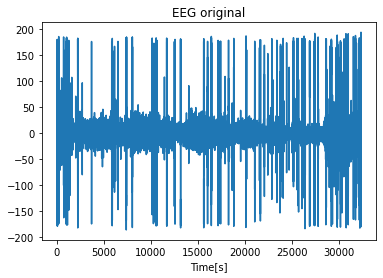

In [25]:
plt.plot(t,outputSignal)
plt.xlabel("Time[s]")
plt.title("EEG original")
plt.show()

[array([-532.59036816, -536.99341873, -539.13189153, ...,  -87.05721121,
       1983.51944576, 1960.29547182]), array([-1.82370975e-01, -1.08992493e+00, -3.33479514e+01, ...,
        9.34709458e+01,  8.59962669e+00, -6.28966630e+02]), array([-1.75472559e-01, -2.92160412e-01,  1.50702288e+00, ...,
        4.43994244e-05,  2.36241244e-05,  2.12562574e-03]), array([-3.16245699e-01, -6.33324852e-01,  4.58632494e+00, ...,
       -1.19346341e-06, -1.02129464e-06, -1.24308836e-06]), array([-4.13214610e-02, -3.69644407e-02,  5.58788362e+00, ...,
        2.91148829e-07,  3.31028494e-07, -7.48211413e-06]), array([ 1.54997029e+00,  5.12980918e+00,  1.68757913e+00, ...,
        1.49944975e-07, -1.97744147e-06,  7.85160633e-06]), array([-1.16357562e+00, -3.42901972e+00,  2.93363083e+00, ...,
        5.39315876e-08,  3.61338857e-07, -8.28941261e-07]), array([ 1.41810436e-01,  2.34655157e-01, -2.96897693e-01, ...,
        1.71475987e-08,  1.27532518e-08,  3.33794461e-08])]


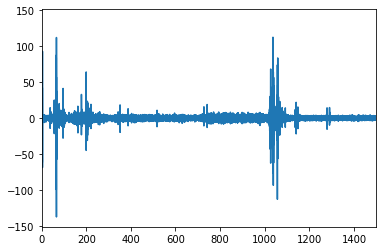

In [26]:
coeff = pywt.wavedec(output, 'db4', level=7) #change level

print(coeff)
new_coeff_alpha = []
new_coeff_beta =  []
new_coeff_delta = []
new_coeff_theta = []
for k in range(len(coeff)):
    new_coeff_alpha.append(np.zeros(len(coeff[k])))

new_coeff_alpha[3]=coeff[3]


output_alpha = pywt.waverec(new_coeff_alpha, 'db4')

plt.plot(t,output_alpha)
plt.xlim(0,1500)
plt.show()
